# 01. Librerías

In [45]:
import os
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras

# Data 
from tqdm import tqdm
from glob import glob
import tensorflow.image as tfi
from tensorflow.keras.utils import load_img, img_to_array

# Data Visulization
import matplotlib.pyplot as plt

# Model Layers
from keras.models import Model
from keras.layers import Layer
from keras.layers import Input
from keras.layers import Conv2D
from keras.layers import Concatenate
from keras.layers import UpSampling2D
from keras.layers import AveragePooling2D
from keras.layers import BatchNormalization
from keras.layers import LeakyReLU, ReLU
from keras.models import Sequential

# Backbone
from tensorflow.keras.applications import ResNet50

# Model Architecture Visualization
from tensorflow.keras.utils import plot_model

# Optimizer
from tensorflow.keras.optimizers import Adam

# Callbacks
from keras.callbacks import ModelCheckpoint, Callback

# Model Layer Visualization
from tf_explain.core.grad_cam import GradCAM

In [46]:
# Specify paths
root_path = '../data/floods_images/'
image_path = '../data/floods_images/Image/'
mask_path = '../data/floods_images/Mask/'
metadata_path = "../data/floods_images/metadata.csv"

In [47]:
# Load file
metadata = pd.read_csv(metadata_path)

# Show
metadata

,Image,Mask
0,0.jpg,0.png
1,1.jpg,1.png
2,2.jpg,2.png
3,3.jpg,3.png
4,4.jpg,4.png
...,...,...
285,1083.jpg,1083.png
286,1084.jpg,1084.png
287,1085.jpg,1085.png
288,1086.jpg,1086.png


In [48]:
def load_image(path:str, SIZE:tuple = (256, 256), mask:bool = False):
    
    '''
    This function is responsible for loading and processing the image. The function takes in the path of the 
    image to be loaded and then loads the image using OpenCV, perform a resize conversionn and cast the image
    to a 32Bit Float Tensor. At last, the image is normalized to change the pixel range from 0 to 255 to
    0 to 1.
    
    Inputs : 
        path : It represents the file path of he image to be loaded.
        size : The desired size in which the image should be resized, default is set to 256 x 256 pixels.
        mask : If the image to be loaded is then the image is a binary map i.e of shape = (*size, 1)
    
    Output:
        image : The processed image whose file path was provided.
    '''
    
    # load Image
    image = load_img(path)
    
    # Convert to an array
    image = img_to_array(image)
    
    # Resize the image
    image = tfi.resize(image, SIZE)
    
    # Convert to Tensor of 32Bit - Float
    image = tf.cast(image, tf.float32)
    
    # Normalize the image
    image = image/255.
    
    # Mask
    if mask:
        image = image[:, :, :1]
        
    # return image
    return image

In [49]:
def load_data(root_path:str=root_path):
    
    '''
    The function is reponsible for loading all the Images and their respective Masks. It does so by first load the file paths of the Images
    then it applies some changes on the Image paths to convert them to Mask Paths. Before loading the Images and Masks, first a empty space
    is created, where the loaded Images and Masks are stored. As last it returns the array of Images and Masks.
    
    Input : 
        root_path : The path to the main directory where both the images & masks are kept.
    
    Outputs : 
        images : Array of all the images present in the data set.
        masks : Array of all the masks present in the data set.
    '''
    
    # Load the Image and Mask paths
    image_paths = sorted(glob(root_path + "Image/*.jpg"))
    mask_paths  = [path.replace("Image", "Mask").replace("jpg", "png") for path in image_paths]
    
    # Create space for loading the images and masks
    images = np.empty(shape=(len(image_paths), 256, 256, 3), dtype=np.float32)
    masks  = np.empty(shape=(len(image_paths), 256, 256, 1), dtype=np.float32)
    
    # load the images and masks
    for i, (img_path, mask_path) in tqdm(enumerate(zip(image_paths, mask_paths)), desc="Loading"):

        # Load the image
        image = load_image(path = img_path, mask = False)
        
        # Load the respective mask
        mask  = load_image(path = mask_path, mask = True)
        
        # Put this into the Space
        images[i] = image
        masks[i]  = mask
    
    # Return the images and Masks
    return images, masks

In [50]:
# Colect All images and masks 
all_images, all_masks = load_data(root_path)

Loading: 290it [00:17, 16.99it/s]


In [51]:
# Split data into Training and Testing
data_len = len(all_images)

# Training set
train_images, train_masks = all_images[:int(data_len*0.8)], all_masks[:int(data_len*0.8)]

# Testing Set
test_images,  test_masks = all_images[int(data_len*0.8):], all_masks[int(data_len*0.8):]

In [52]:
def show_images(images, masks, n_images, SIZE=(15,8)) -> None:
    
    '''
    This function is responsible for visualising N number of images from the given set of Images and the respective masks.
    It does so by plotting the images and masks using matplotlib.
    
    Inputs : 
        images   : The collection of images.
        masks    : The collection of masks.
        n_images : Total number of images to be plotted.
        SIZE     : Size of each plot.
        
    '''
    
    # Plot n Images
    for i in range(n_images):

        # Plotting Configuration
        plt.figure(figsize=SIZE)
    
        # Select a image Randomly
        id = np.random.randint(len(images))
        
        # Plot the Image
        plt.subplot(1, 3, 1)
        plt.imshow(images[id])
        plt.title("Image")
        plt.axis('off')
        
        # Plot the Mask
        plt.subplot(1, 3, 2)
        plt.imshow(masks[id], cmap='gray')
        plt.title("Mask")
        plt.axis('off')
        
        # Plot the Overlapping Mask
        plt.subplot(1, 3, 3)
        plt.imshow(images[id], cmap='gray')
        plt.imshow(masks[id], cmap='gray', alpha=0.5)
        plt.title("Overlapping Mask")
        plt.axis('off')
        
        # Shwo a Single Frame : This is done to speed up plotting for large number images
        plt.tight_layout()
        plt.show()

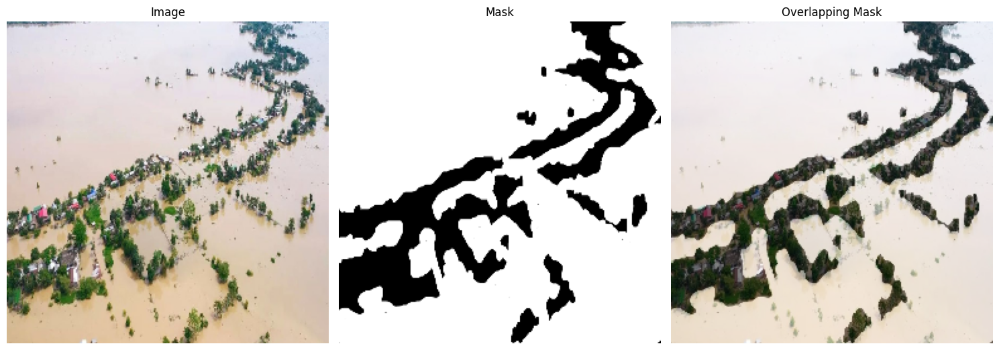

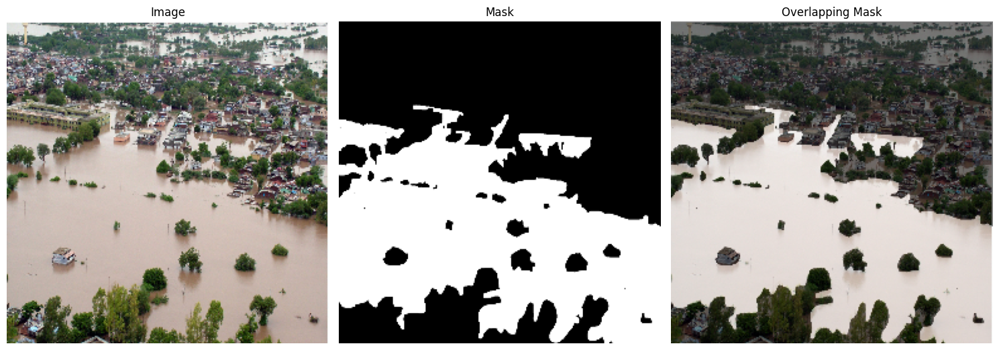

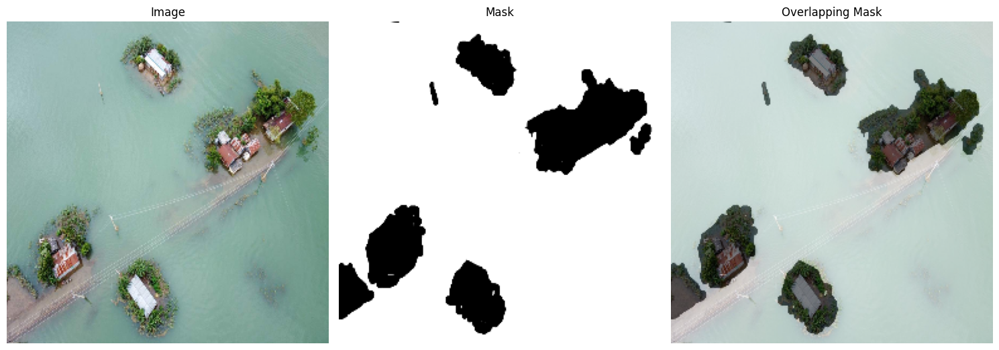

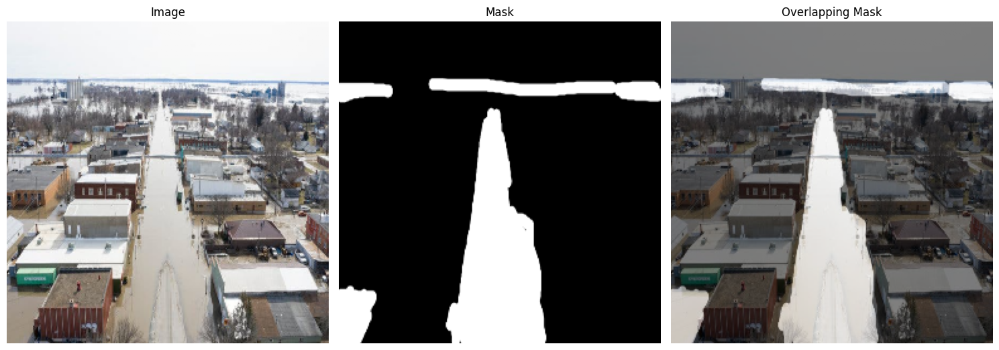

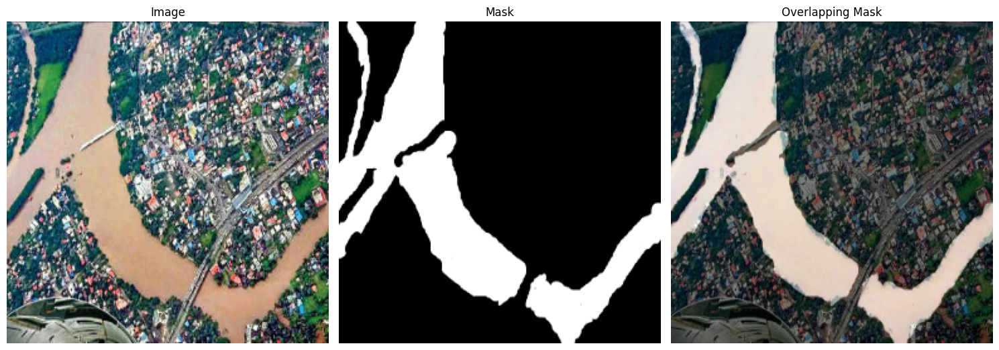

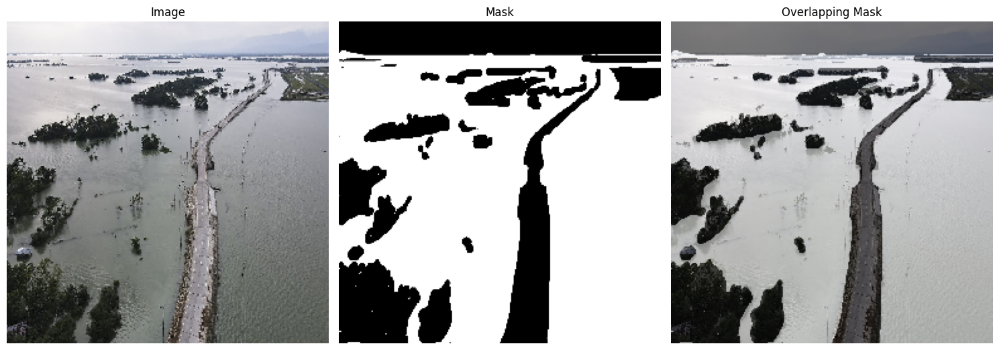

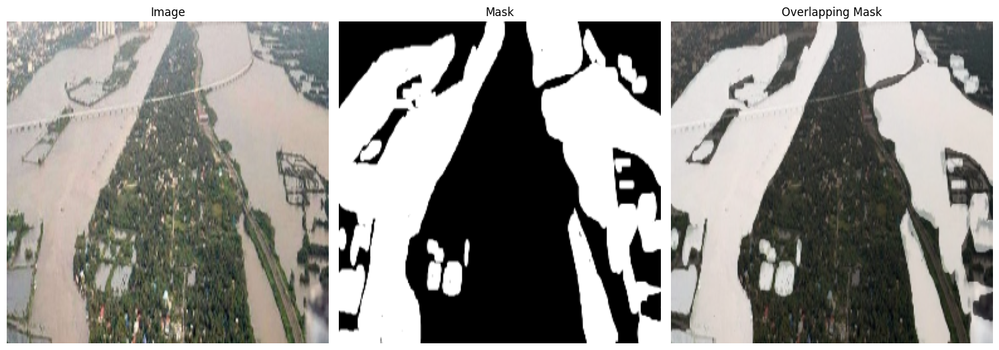

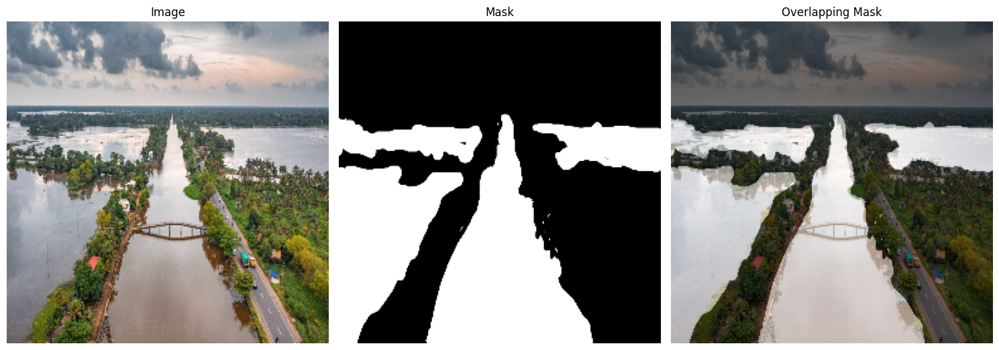

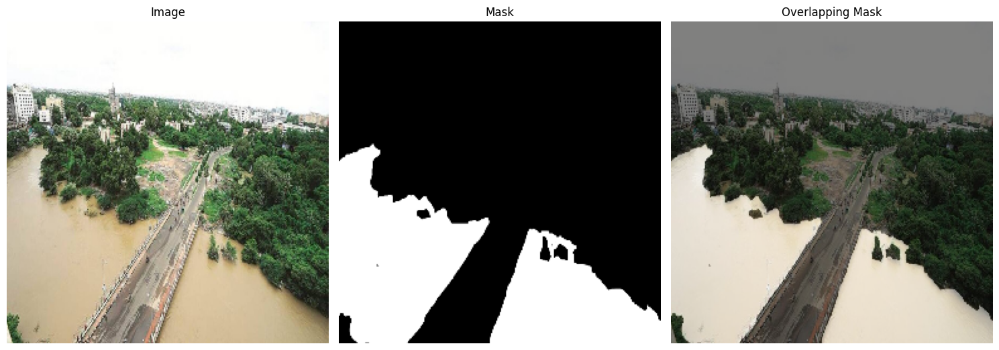

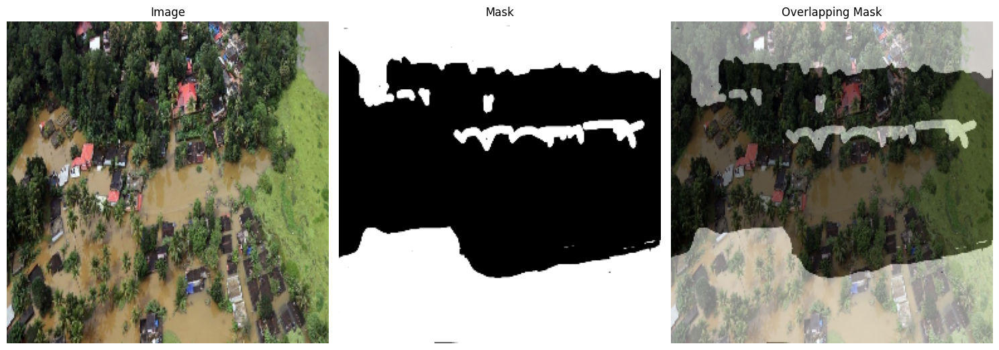

In [53]:
show_images(train_images, train_masks, n_images=10)

In [54]:
class ConvBlock(Layer):
    
    '''
    As in the Model implementation uses, Conv2D -> BatchNormalization -> ReLU. In the same fashion again and again, that why we have created a Single Layer
    which apply this operation. So ConvBlock = Conv2D -> BatchNormalization -> ReLU. This helps us in implementation.
    '''
    
    def __init__(self, filters:int = 256, kernel_size:int = 3, dilation_rate:int = 1, **kwargs) -> None:
        super(ConvBlock, self).__init__(**kwargs)
        
        # Define Parameters
        self.filters = filters
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate
        
        # Define the model 
        self.net = Sequential([
            Conv2D(filters, kernel_size=kernel_size, padding='same', strides=1, dilation_rate=dilation_rate, activation=None, use_bias=False),
            BatchNormalization(),
            ReLU()
        ])
    
    def call(self, X):
        # Apply the layers
        return self.net(X)
    
    def get_config(self):
        base_config = super().get_config()
        
        return {
            **base_config,
            "filters":self.filters,
            "kernel_size":self.kernel_size,
            "dilation_rate":self.dilation_rate
        }

In [55]:
def AtrousSpatialPyramidPooling(X):
    
    # Shape
    _, H, W, C = X.shape
    
    # Image Pooling 
    image_pool = AveragePooling2D(pool_size=(H, W), name="ASPP-ImagePool-AP")(X)
    image_pool = ConvBlock(kernel_size=1, name="ASPP-ImagePool-CB")(image_pool)
    image_pool = UpSampling2D(size=(H//image_pool.shape[1], W//image_pool.shape[1]), name="ASPP-ImagePool-US")(image_pool)
    
    # Astrous Layers
    conv_1  = ConvBlock(kernel_size=1, dilation_rate=1, name="ASPP-Conv1")(X)
    conv_6  = ConvBlock(kernel_size=3, dilation_rate=6, name="ASPP-Conv6")(X)
    conv_12 = ConvBlock(kernel_size=3, dilation_rate=12, name="ASPP-Conv12")(X)
    conv_18 = ConvBlock(kernel_size=3, dilation_rate=18, name="ASPP-Conv18")(X)
    
    # Combine All
    combined = Concatenate(name="ASPP-Concatenate")([image_pool, conv_1, conv_6, conv_12, conv_18])
    output = ConvBlock(kernel_size=1, name="ASPP-Out")(combined)
    
    return output

In [56]:
# Model Specifications
IMAGE_SIZE = 256
MODEL_NAME = "DeepLab-FloodArea"

# Input Layer
inputs = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# Backbone
backbone = ResNet50(input_tensor=inputs, weights='imagenet', include_top=False)

# High Level Features
DCNN = backbone.get_layer('conv4_block6_2_relu').output
ASPP = AtrousSpatialPyramidPooling(DCNN)
ASPP = UpSampling2D(size=(
    IMAGE_SIZE//4//ASPP.shape[1], IMAGE_SIZE//4//ASPP.shape[2]
), name="ASPP-UpSample-Out")(ASPP)

# Low Level Features
LLF = backbone.get_layer('conv2_block3_2_relu').output
LLF = ConvBlock(filters=48, kernel_size=1, name="LLF-ConvBlock")(LLF)

# Combine
concat = Concatenate(axis=-1, name="Concat-LLF-HLF")([LLF, ASPP])
y = ConvBlock(name="TopConvBlock1")(concat)
y = ConvBlock(name="TopConvBlock2")(y)
y = UpSampling2D(size=(
    IMAGE_SIZE//y.shape[1], IMAGE_SIZE//y.shape[2]
), name="Feature-UpSample")(y)

# Output Layer
output = Conv2D(filters=1, kernel_size=3, padding='same', activation='sigmoid', use_bias=False, name="OutputLayer")(y)

# Model
DeepLabV3 = Model(inputs, output, name=MODEL_NAME)

In [57]:
DeepLabV3.summary()

Model: "DeepLab-FloodArea"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ InputLayer          │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 262, 262,  │          0 │ InputLayer[0][0]  │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 128, 128,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 128, 128,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 128, 128,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 130, 130,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 64, 64,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 64, 64,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 64, 64,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 64, 64,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 64, 64,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 64, 64,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 64, 64,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 64, 64,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 64, 64,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_3_c

 Total params: 11,854,144 (45.22 MB)

 Trainable params: 11,821,408 (45.10 MB)

 Non-trainable params: 32,736 (127.88 KB)

In [58]:
plot_model(DeepLabV3, MODEL_NAME+".png", dpi=96, show_shapes=True)

In [59]:
def show_model_preds(images, masks, model, SIZE:tuple = (15,8)) -> None:
    # Collect Image and Mask
    id = np.random.randint(len(test_images))
    image, mask = images[id], masks[id]
    
    # Make Prediction 
    pred_mask = model.predict(tf.expand_dims(image, axis=0))
            
    # Plot Size
    plt.figure(figsize=SIZE)
    
    # Plot Image
    plt.subplot(1,3,1)
    plt.imshow(image)
    plt.title("Input Image")
    plt.axis('off')
    
    # Plot Original Mask
    plt.subplot(1,3,2)
    plt.title("Expected Mask")
    plt.imshow(mask, cmap='gray')
    plt.axis('off')
            
    # Plot Predicted Mask
    plt.subplot(1,3,3)
    plt.imshow(tf.squeeze(pred_mask), cmap='gray')
    plt.title("Predicted Mask")
    plt.axis('off')

    # Show the Final Plot
    plt.show()

In [60]:
class ShowProgress(Callback):
    
    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%10==0:
            show_model_preds(test_images, test_masks, self.model)

Epoch 1/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 241s 7s/step - loss: 0.3988 - val_loss: 2587.6772
Epoch 2/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 197s 7s/step - loss: 0.3295 - val_loss: 1122.4170
Epoch 3/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 171s 6s/step - loss: 0.3097 - val_loss: 523.0781
Epoch 4/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 172s 6s/step - loss: 0.3111 - val_loss: 26687.4043
Epoch 5/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 170s 6s/step - loss: 0.2960 - val_loss: 1524.8989
Epoch 6/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 171s 6s/step - loss: 0.2807 - val_loss: 0.7387
Epoch 7/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 170s 6s/step - loss: 0.2846 - val_loss: 2.8456
Epoch 8/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.2684 - val_loss: 381.1677
Epoch 9/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.2637 - val_loss: 3.2618
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/stepep - loss: 0.271


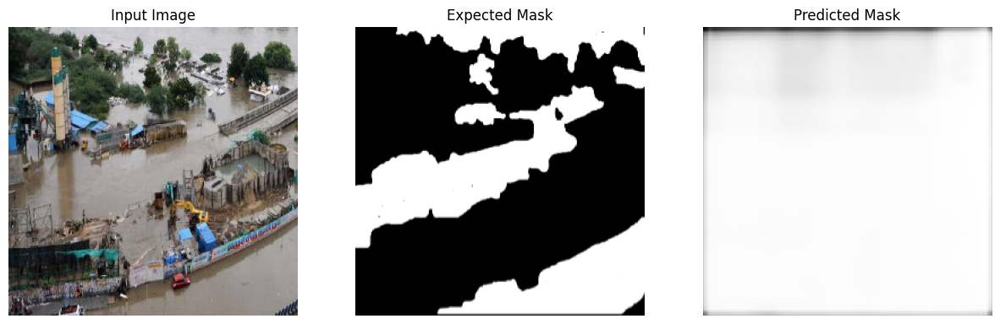

29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.2720 - val_loss: 2.6652
Epoch 11/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.2867 - val_loss: 9.7645
Epoch 12/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.2913 - val_loss: 92.8728
Epoch 13/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.2525 - val_loss: 43.0979
Epoch 14/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.2424 - val_loss: 3.0521
Epoch 15/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.2440 - val_loss: 22.9854
Epoch 16/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.2335 - val_loss: 4.9135
Epoch 17/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.2289 - val_loss: 5.1518
Epoch 18/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.2218 - val_loss: 20.2243
Epoch 19/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.2405 - val_loss: 6.4553
Epoch 20/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step- loss: 0.21


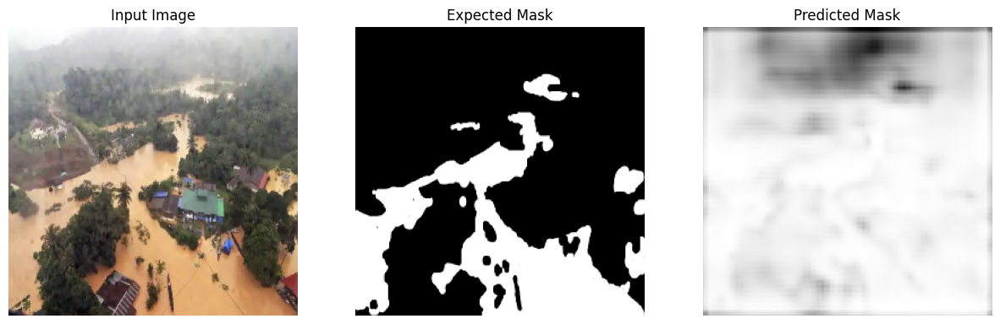

29/29 ━━━━━━━━━━━━━━━━━━━━ 170s 6s/step - loss: 0.2158 - val_loss: 1.9629
Epoch 21/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.2302 - val_loss: 3.6246
Epoch 22/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.2095 - val_loss: 2.5928
Epoch 23/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.2377 - val_loss: 1.4758
Epoch 24/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1903 - val_loss: 0.9663
Epoch 25/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.1978 - val_loss: 1.1904
Epoch 26/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.1848 - val_loss: 1.2074
Epoch 27/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1825 - val_loss: 0.8173
Epoch 28/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.1768 - val_loss: 0.8751
Epoch 29/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1627 - val_loss: 0.7587
Epoch 30/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step- loss: 0.14


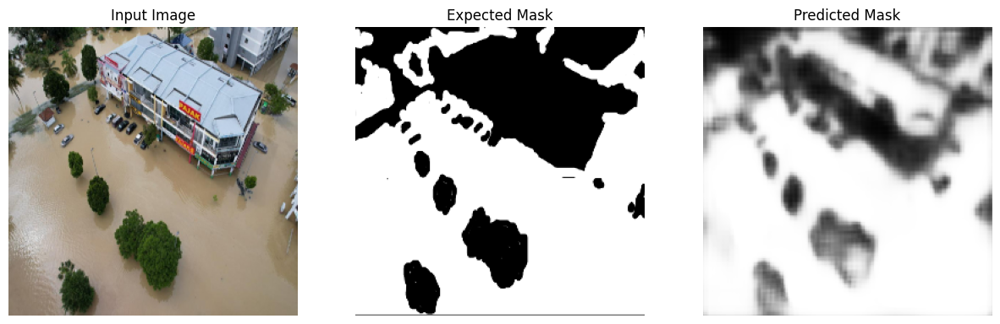

29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.1501 - val_loss: 0.7919
Epoch 31/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 173s 6s/step - loss: 0.1554 - val_loss: 0.5124
Epoch 32/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 170s 6s/step - loss: 0.1686 - val_loss: 0.9746
Epoch 33/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 173s 6s/step - loss: 0.1842 - val_loss: 0.3662
Epoch 34/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 195s 6s/step - loss: 0.1648 - val_loss: 0.2868
Epoch 35/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 166s 6s/step - loss: 0.1407 - val_loss: 0.2893
Epoch 36/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 170s 6s/step - loss: 0.1313 - val_loss: 0.2698
Epoch 37/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.1365 - val_loss: 0.2438
Epoch 38/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1286 - val_loss: 0.2728
Epoch 39/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 166s 6s/step - loss: 0.1433 - val_loss: 0.4269
Epoch 40/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step- loss: 0.13


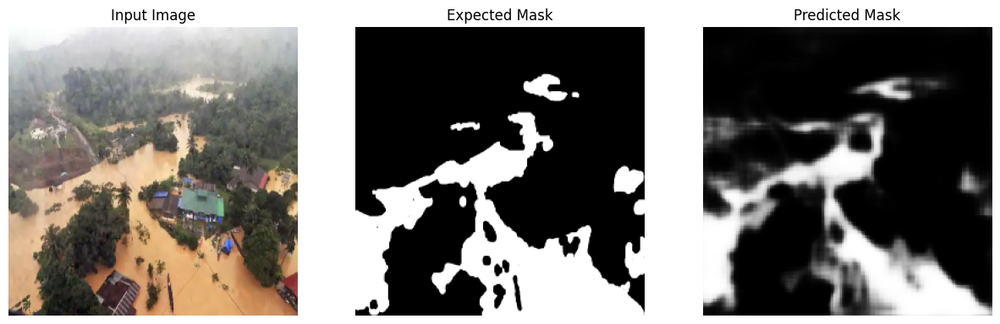

29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.1338 - val_loss: 0.2958
Epoch 41/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1417 - val_loss: 0.2639
Epoch 42/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1448 - val_loss: 0.2575
Epoch 43/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1255 - val_loss: 0.2648
Epoch 44/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.1195 - val_loss: 0.2378
Epoch 45/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.1171 - val_loss: 0.2526
Epoch 46/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1202 - val_loss: 0.2830
Epoch 47/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.1225 - val_loss: 0.3818
Epoch 48/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1147 - val_loss: 0.2839
Epoch 49/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 171s 6s/step - loss: 0.1337 - val_loss: 0.6464
Epoch 50/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step- loss: 0.13


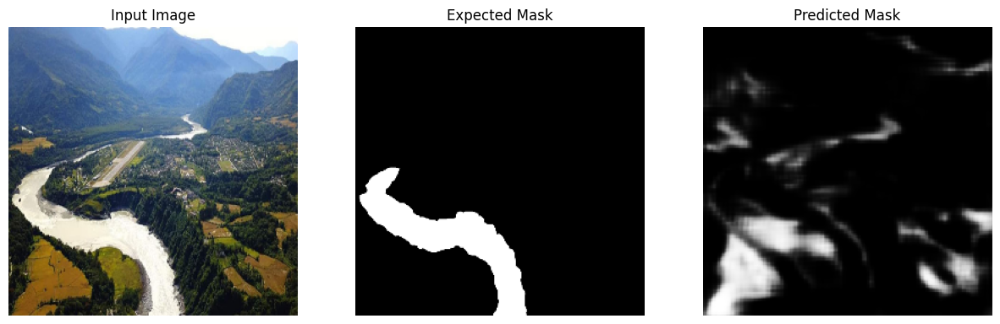

29/29 ━━━━━━━━━━━━━━━━━━━━ 171s 6s/step - loss: 0.1325 - val_loss: 0.3580
Epoch 51/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.1176 - val_loss: 0.2746
Epoch 52/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.1121 - val_loss: 0.2917
Epoch 53/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.1065 - val_loss: 0.2350
Epoch 54/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.0987 - val_loss: 0.2362
Epoch 55/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.0967 - val_loss: 0.2233
Epoch 56/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 6s/step - loss: 0.0944 - val_loss: 0.2312
Epoch 57/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.0945 - val_loss: 0.2500
Epoch 58/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.0860 - val_loss: 0.2537
Epoch 59/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.0873 - val_loss: 0.2514
Epoch 60/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step- loss: 0.08


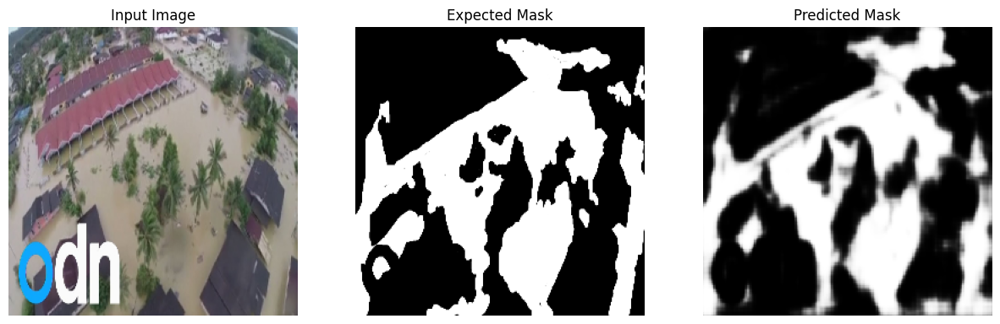

29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.0807 - val_loss: 0.2482
Epoch 61/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.0812 - val_loss: 0.2470
Epoch 62/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.0767 - val_loss: 0.2398
Epoch 63/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.0782 - val_loss: 0.2666
Epoch 64/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 185s 6s/step - loss: 0.0743 - val_loss: 0.2620
Epoch 65/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 281s 10s/step - loss: 0.0751 - val_loss: 0.2888
Epoch 66/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 273s 9s/step - loss: 0.0714 - val_loss: 0.2728
Epoch 67/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 267s 9s/step - loss: 0.0680 - val_loss: 0.2824
Epoch 68/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 258s 9s/step - loss: 0.0696 - val_loss: 0.2897
Epoch 69/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 335s 11s/step - loss: 0.0636 - val_loss: 0.2904
Epoch 70/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step- loss: 0.06


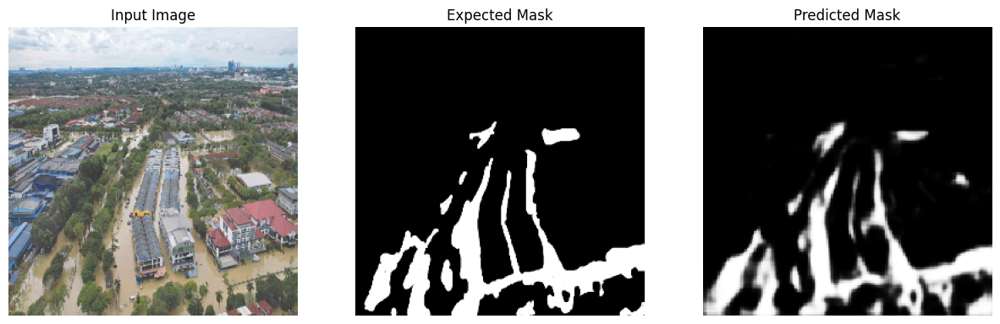

29/29 ━━━━━━━━━━━━━━━━━━━━ 181s 6s/step - loss: 0.0627 - val_loss: 0.2734
Epoch 71/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 168s 6s/step - loss: 0.0615 - val_loss: 0.2790
Epoch 72/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 164s 6s/step - loss: 0.0641 - val_loss: 0.2961
Epoch 73/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 164s 6s/step - loss: 0.0654 - val_loss: 0.3095
Epoch 74/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 164s 6s/step - loss: 0.0652 - val_loss: 0.3033
Epoch 75/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 165s 6s/step - loss: 0.0632 - val_loss: 0.3023
Epoch 76/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 165s 6s/step - loss: 0.0618 - val_loss: 0.3082
Epoch 77/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 165s 6s/step - loss: 0.0613 - val_loss: 0.3116
Epoch 78/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 164s 6s/step - loss: 0.0576 - val_loss: 0.3025
Epoch 79/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 167s 6s/step - loss: 0.0558 - val_loss: 0.2898
Epoch 80/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step- loss: 0.06


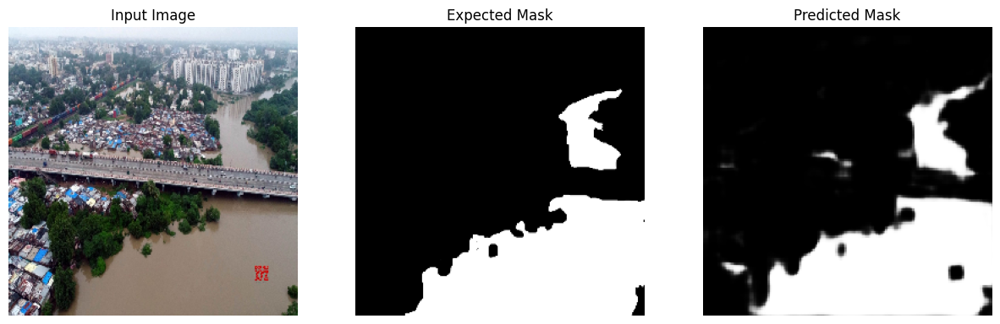

29/29 ━━━━━━━━━━━━━━━━━━━━ 165s 6s/step - loss: 0.0675 - val_loss: 0.3000
Epoch 81/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 164s 6s/step - loss: 0.1682 - val_loss: 1126.7045
Epoch 82/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 165s 6s/step - loss: 0.2548 - val_loss: 1.5197
Epoch 83/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 164s 6s/step - loss: 0.2144 - val_loss: 2.9301
Epoch 84/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 164s 6s/step - loss: 0.1707 - val_loss: 24.8575
Epoch 85/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 163s 6s/step - loss: 0.1460 - val_loss: 31.7248
Epoch 86/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 163s 6s/step - loss: 0.1352 - val_loss: 2.0981
Epoch 87/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 162s 6s/step - loss: 0.1036 - val_loss: 1.0332
Epoch 88/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 164s 6s/step - loss: 0.0916 - val_loss: 0.2949
Epoch 89/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 163s 6s/step - loss: 0.0929 - val_loss: 0.2579
Epoch 90/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step- loss: 0.11


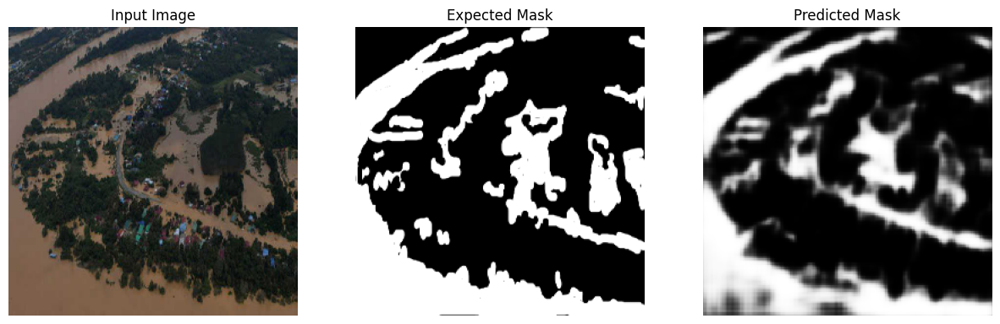

29/29 ━━━━━━━━━━━━━━━━━━━━ 163s 6s/step - loss: 0.1145 - val_loss: 0.4730
Epoch 91/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 163s 6s/step - loss: 0.1426 - val_loss: 0.3623
Epoch 92/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 162s 6s/step - loss: 0.1158 - val_loss: 0.2924
Epoch 93/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 162s 6s/step - loss: 0.0857 - val_loss: 0.3612
Epoch 94/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 163s 6s/step - loss: 0.0774 - val_loss: 0.2576
Epoch 95/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 319s 11s/step - loss: 0.0715 - val_loss: 0.2847
Epoch 96/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 278s 10s/step - loss: 0.0657 - val_loss: 0.2711
Epoch 97/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 259s 9s/step - loss: 0.0640 - val_loss: 0.2795
Epoch 98/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 203s 7s/step - loss: 0.0588 - val_loss: 0.2745
Epoch 99/100
29/29 ━━━━━━━━━━━━━━━━━━━━ 200s 7s/step - loss: 0.0587 - val_loss: 0.2881
Epoch 100/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step- loss: 0.06


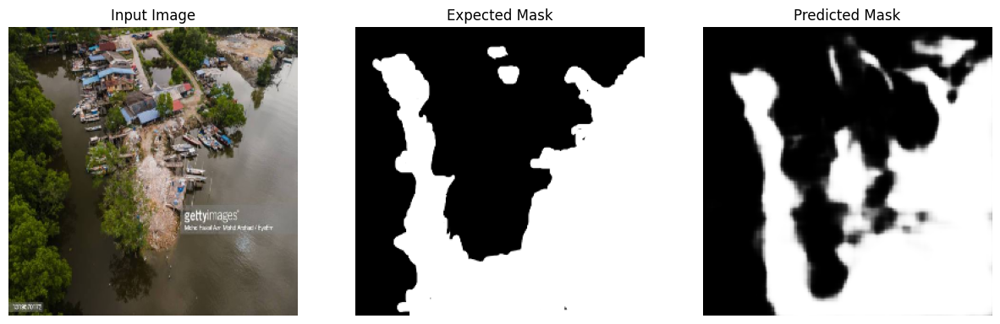

29/29 ━━━━━━━━━━━━━━━━━━━━ 215s 7s/step - loss: 0.0615 - val_loss: 0.2899


In [64]:
# Compile
DeepLabV3.compile(
    loss='binary_crossentropy',
    optimizer="adam"
)

# Callbacks
callbacks = [
    ModelCheckpoint(MODEL_NAME+".keras", save_best_only=True),
    ShowProgress()
]

# Train
history = DeepLabV3.fit(
    train_images, train_masks,
    validation_data=(test_images, test_masks),
    epochs=100,
    callbacks=callbacks,
    batch_size=8,
)

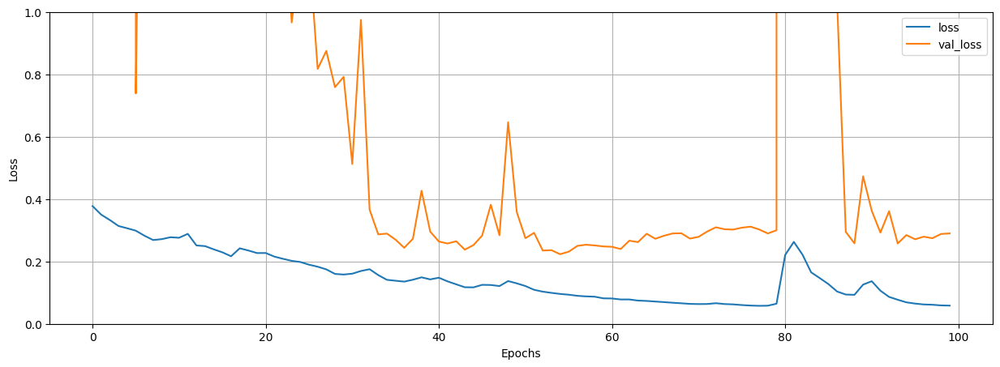

In [65]:
pd.DataFrame(history.history).plot(figsize=(15,5))
plt.ylim([0.0,1.0])
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.grid()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


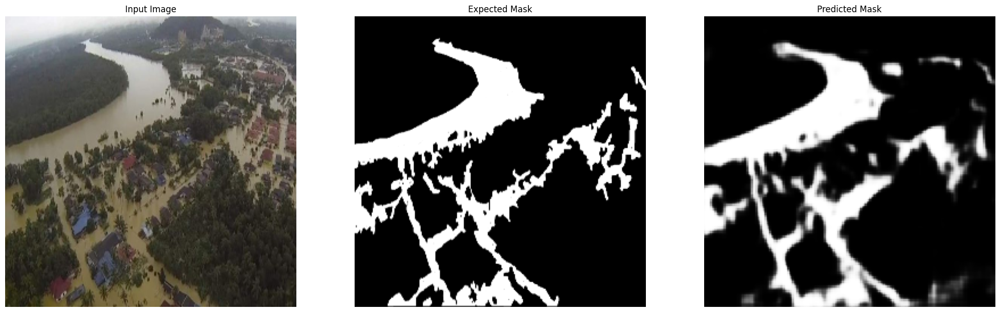

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


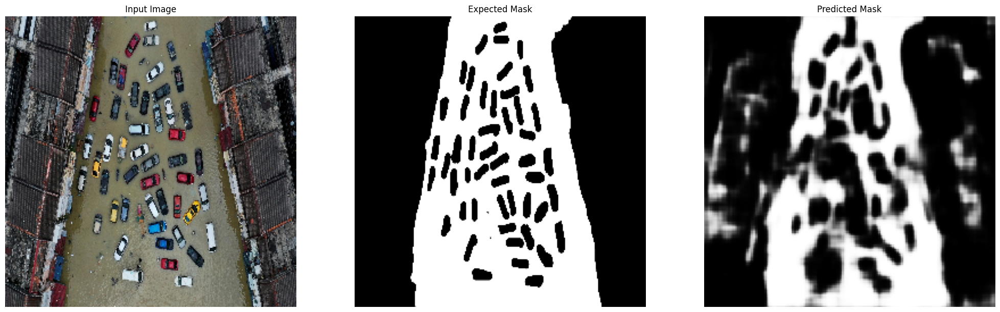

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


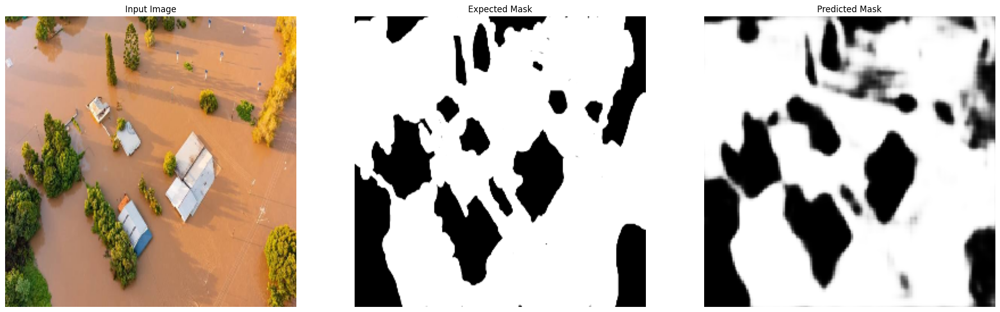

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


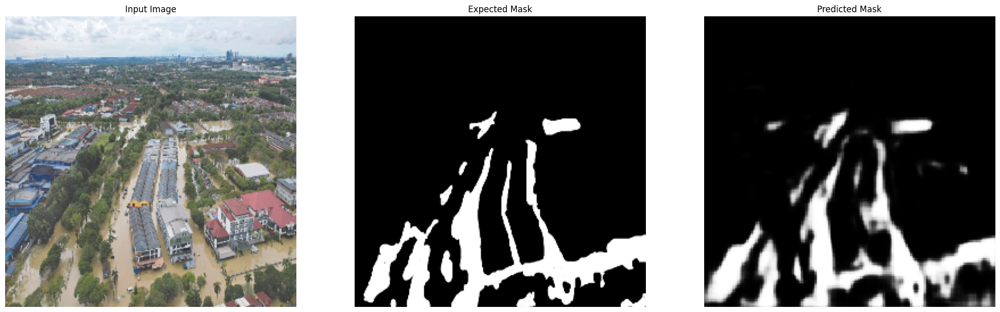

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


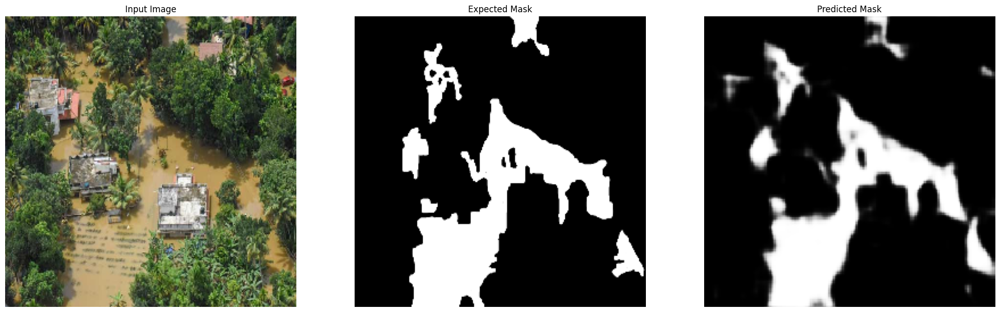

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


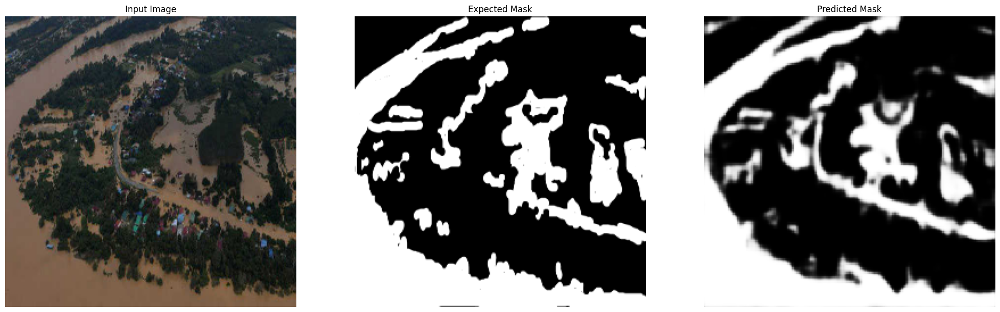

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


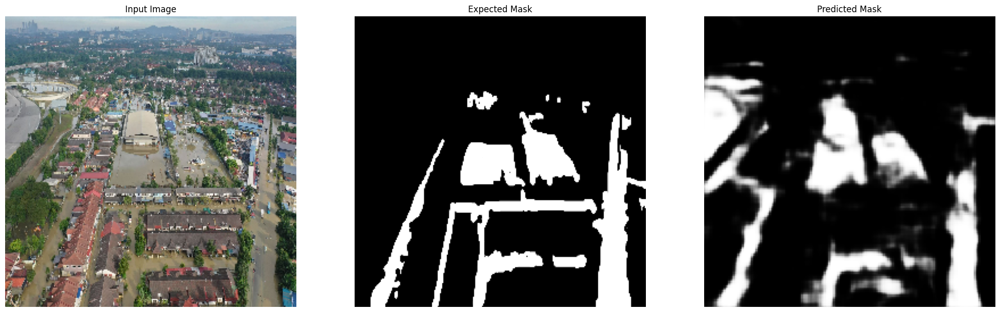

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


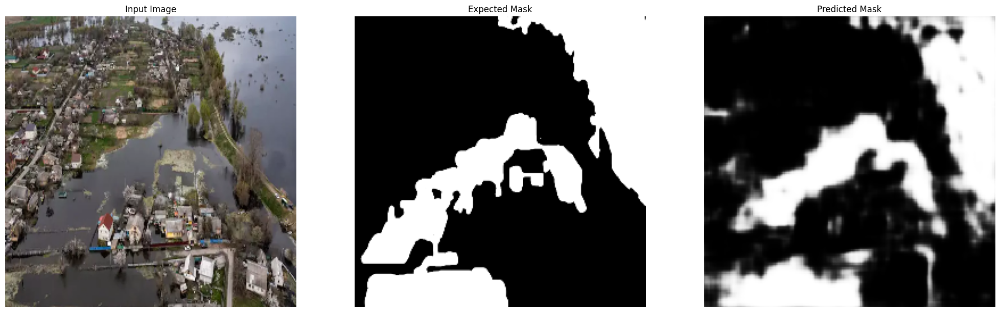

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 780ms/step


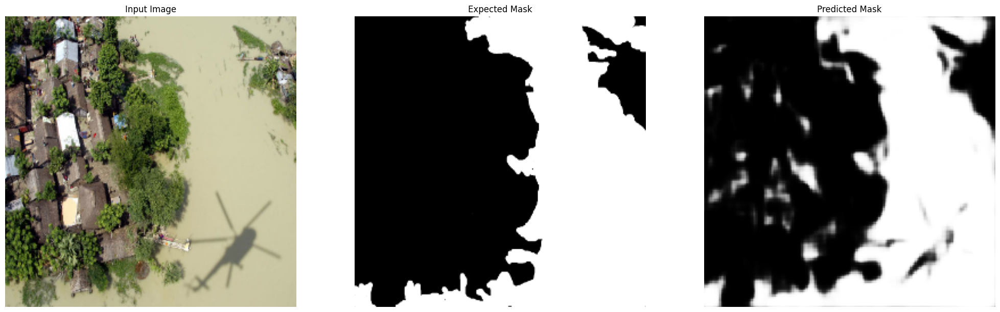

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


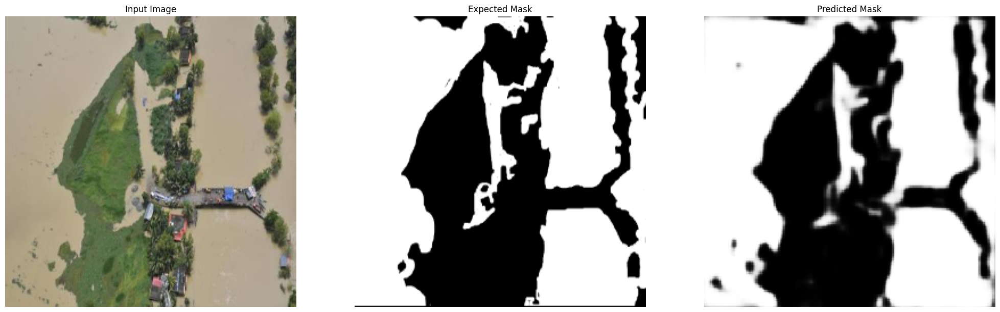

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


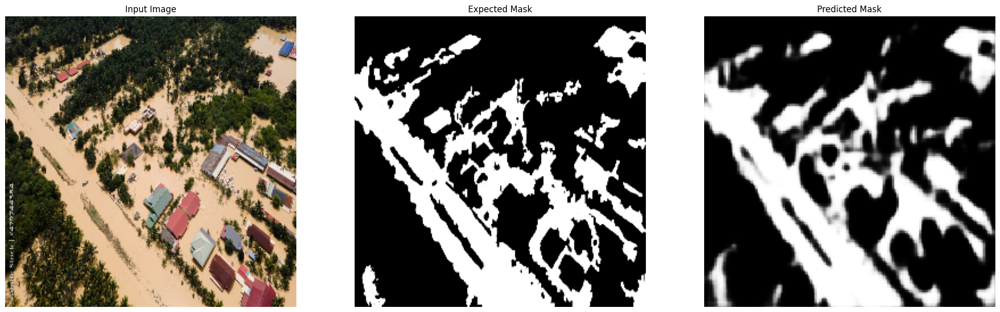

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


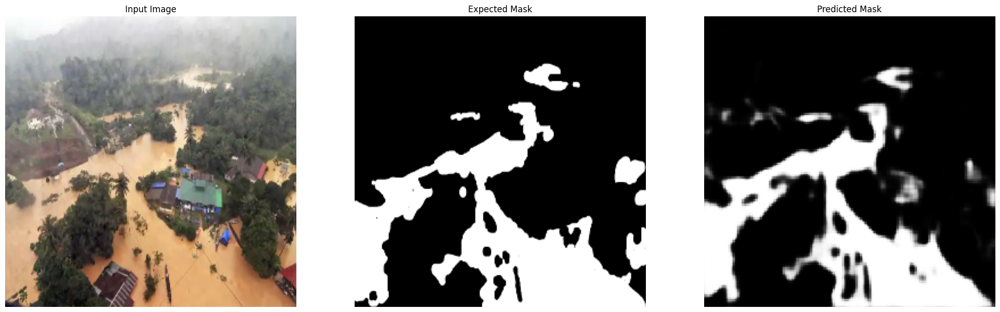

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


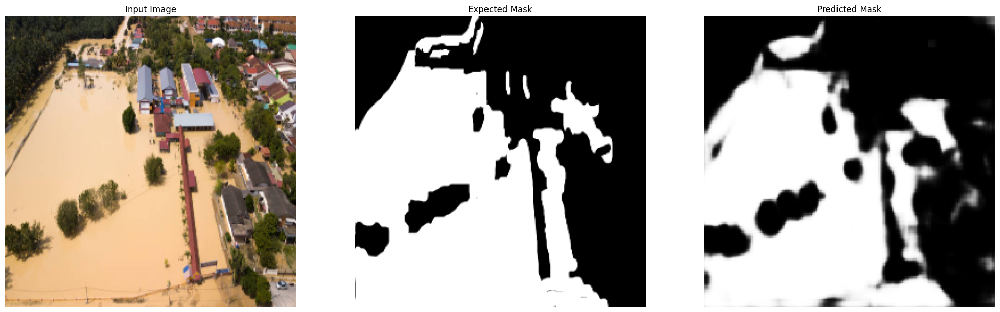

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


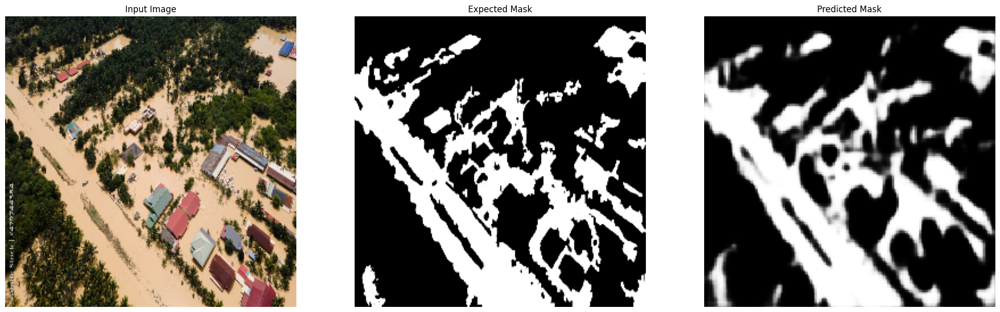

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


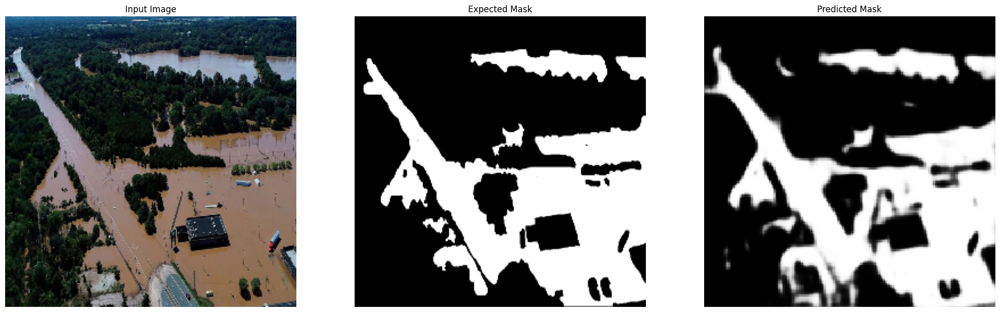

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


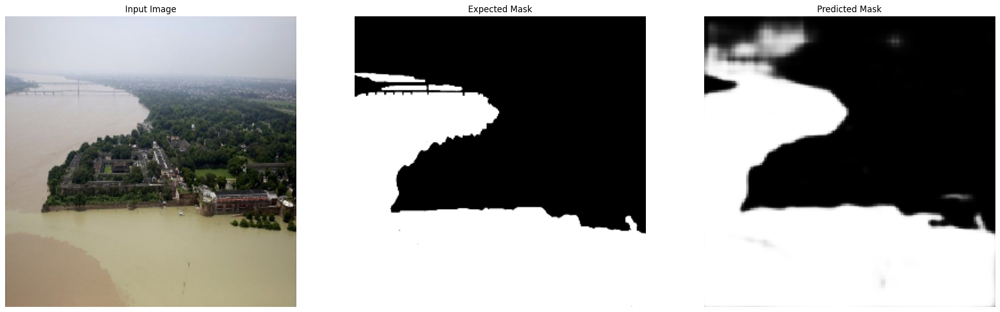

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


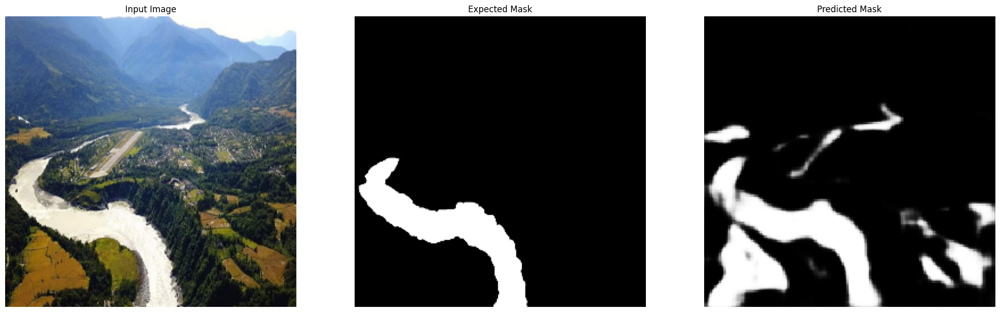

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


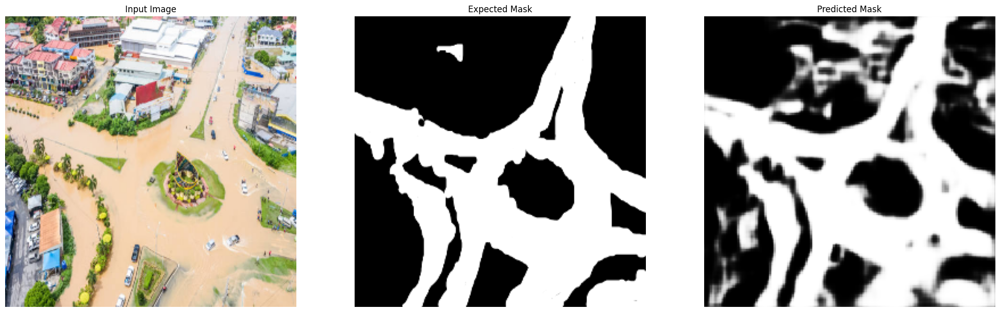

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


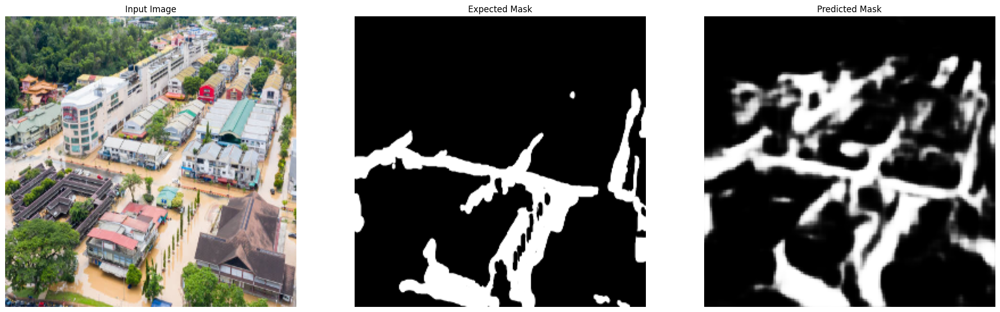

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


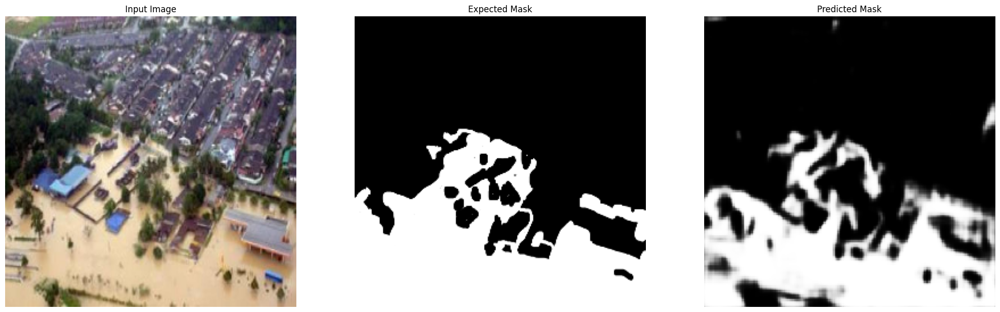

In [66]:
for i in range(20):
    show_model_preds(test_images, test_masks, model=DeepLabV3, SIZE=(25,8)) 